### Refugee Movement Around the World Analysis

https://github.com/rfordatascience/tidytuesday/blob/master/data/2023/2023-08-22/readme.md

In [1]:
import neo4j
import pandas as pd
from IPython.display import display, Image
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
population = pd.read_csv('population.csv')

# Map country three letter codes to names (e.g., USA == United States of America) 
origin_country_dict = dict(zip(population['coo'], population['coo_name']))
asylum_country_dict = dict(zip(population['coa'], population['coa_name']))
country_name_dict = origin_country_dict | asylum_country_dict
print(f'{len(country_name_dict)} unique countries in dataset, with \
{len(origin_country_dict)} origin and {len(asylum_country_dict)} asylum.')

# Groupby to get overall refugee and asylum seeker counts
gb = population.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()
gb.reset_index(inplace=True)
gb

In [3]:
#Qiong--Test Alternative Options
#Remove unqualified rows first before creating relationship

population2=population[population['refugees']>0]
population3=population2[population2['coo']!=population2['coa']]

# Map country three letter codes to names (e.g., USA == United States of America) 
origin_country_dict2 = dict(zip(population3['coo'], population3['coo_name']))
asylum_country_dict2 = dict(zip(population3['coa'], population3['coa_name']))
country_name_dict2 = origin_country_dict2 | asylum_country_dict2
print(f'{len(country_name_dict2)} unique countries in dataset, with \
{len(origin_country_dict2)} origin and {len(asylum_country_dict2)} asylum.')

#2 Countries only accepting refugees, not generating refugees

# Groupby to get overall refugee and asylum seeker counts
gb2 = population3.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()
gb2.reset_index(inplace=True)
gb2

205 unique countries in dataset, with 203 origin and 177 asylum.


/tmp/ipykernel_23/3685920724.py:17: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  gb2 = population3.groupby(['coo', 'coa'])['refugees', 'asylum_seekers'].sum()


,coo,coa,refugees,asylum_seekers
0,AFG,ALB,19,0
1,AFG,ARE,203,529
2,AFG,ARG,72,28
3,AFG,ARM,24,0
4,AFG,AUL,113114,20090
...,...,...,...,...
5645,ZIM,SWI,173,74
5646,ZIM,THA,35,0
5647,ZIM,TUR,6,59
5648,ZIM,USA,16123,7495


#### Connect, login, create driver, create session; with community edition, we can only use 1 database, the "neo4j" database

In [4]:
driver = neo4j.GraphDatabase.driver(uri="neo4j://neo4j:7687", auth=("neo4j","ucb_mids_w205"))

In [5]:
session = driver.session(database="neo4j")

#### Functions to Manage neo4j data

In [6]:
def my_neo4j_wipe_out_database():
    "wipe out database by deleting all nodes and relationships"
    
    query = "match (node)-[relationship]->() delete node, relationship"
    session.run(query)
    
    query = "match (node) delete node"
    session.run(query)

In [7]:
def my_neo4j_run_query_pandas(query, **kwargs):
    "run a query and return the results in a pandas dataframe"
    
    result = session.run(query, **kwargs)
    
    df = pd.DataFrame([r.values() for r in result], columns=result.keys())
    
    return df

In [8]:
def my_neo4j_nodes_relationships():
    "print all the nodes and relationships"
   
    print("-------------------------")
    print("  Nodes:")
    print("-------------------------")
    
    query = """
        match (n) 
        return n.name as node_name, labels(n) as labels
        order by n.name
    """
    
    df = my_neo4j_run_query_pandas(query)
    
    number_nodes = df.shape[0]
    
    display(df)
    
    print("-------------------------")
    print("  Relationships:")
    print("-------------------------")
    
    query = """
        match (n1)-[r]->(n2) 
        return n1.name as node_name_1, labels(n1) as node_1_labels, 
            type(r) as relationship_type, n2.name as node_name_2, labels(n2) as node_2_labels
        order by node_name_1, node_name_2
    """
    
    df = my_neo4j_run_query_pandas(query)
    
    number_relationships = df.shape[0]
    
    display(df)
    
    density = (2 * number_relationships) / (number_nodes * (number_nodes - 1))
    
    print("-------------------------")
    print("  Density:", f'{density:.1f}')
    print("-------------------------")

### Creating Graph 1 and 2

#### Graph 1 : Countries Accepting Refugees
Create a node for each country, with a one way relationship from the country the refugees are <b>emigrating from</b> to the country the refugees are <b>immigrating t</b>o, with the <b>weight of the relationship the number of refugees</b>.

In [9]:
my_neo4j_wipe_out_database()
accept_refugees = "CREATE"

In [10]:
for c_code, c_name in origin_country_dict2.items():
    temp_string = "(" + c_code + ":Country {name: \"" + c_name + "\"}),"
    accept_refugees = accept_refugees + temp_string
    
# Skip where origin/destination country is the same
# Skip where refugees count is 0
coo_to_coa = []
for i in range(0, len(gb2)):
        coo_to_coa.append(
            "("
            + gb2.iloc[i]['coo']
            + ")-[:IS_CONNECTED_TO {weight: " + str(gb2.iloc[i]['refugees'])
            + "}]->("
            + gb2.iloc[i]['coa']
            + ")"
        )
accept_refugees = accept_refugees + ', '.join(coo_to_coa)

In [11]:
def my_create_graph_1_accept_refugees():
    "create the connected graph"   
    my_neo4j_wipe_out_database()
    query = accept_refugees

    session.run(query)

In [12]:
# check
coo_to_coa[0]

'(AFG)-[:IS_CONNECTED_TO {weight: 19}]->(ALB)'

In [13]:
my_create_graph_1_accept_refugees()

In [14]:
my_neo4j_nodes_relationships()
##203 unique origins, 2 unknown (SXM and FSM) should be ones only has destination but no origins

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
200,Yemen,[Country]
201,Zambia,[Country]
202,Zimbabwe,[Country]
203,None,[]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Albania,[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Argentina,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Armenia,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Australia,[Country]
4,Afghanistan,[Country],IS_CONNECTED_TO,Austria,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Thailand,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Türkiye,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,United Kingdom of Great Britain and Northern I...,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,United States of America,[Country]


-------------------------
  Density: 0.3
-------------------------


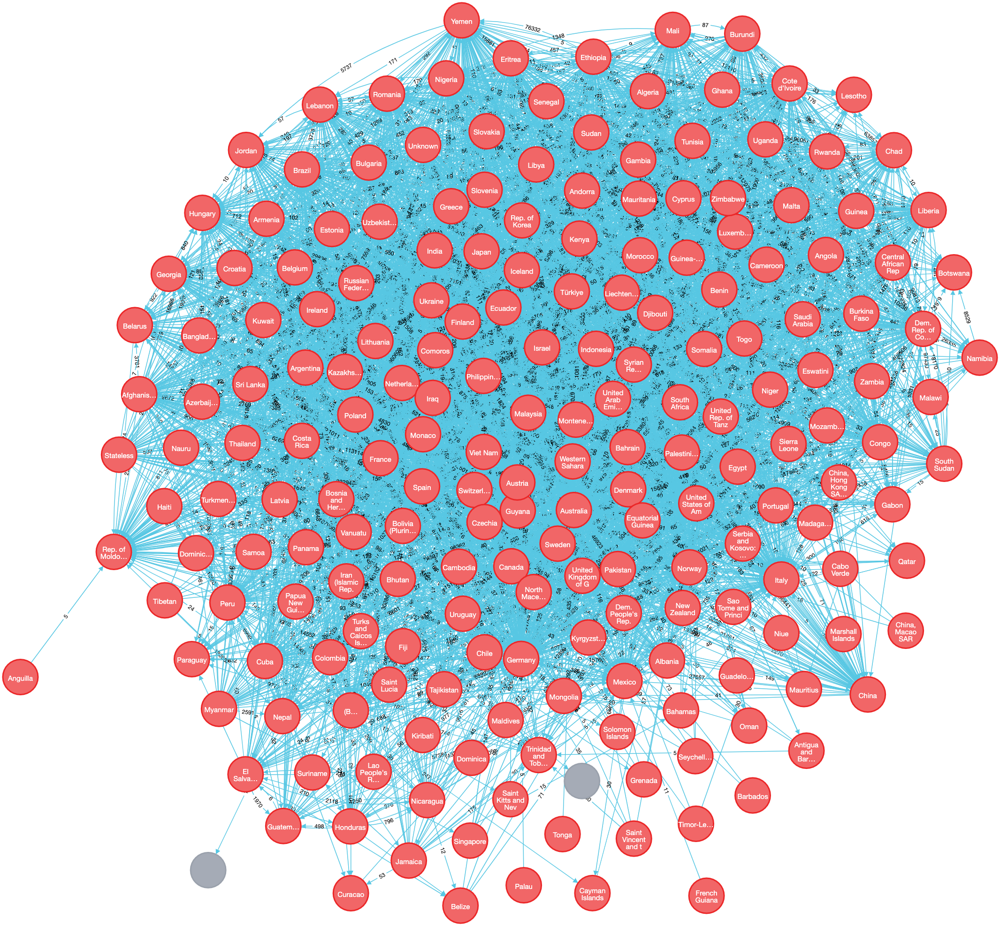

In [29]:
Image(filename='viz/Total Generating Refugee2.png')

### Graph 2 : Countries of Origin of Refugees
Create a node for each country, with a one way relationship from the country the refugees are <b>immmigrating to</b> from the country the refugees are <b>emmigrating from</b>, with the <b>weight of the relationship the number of refugees</b>.

In [15]:
my_neo4j_wipe_out_database()
origin_refugees = "CREATE"

In [16]:
for c_code, c_name in asylum_country_dict2.items():#Here you use country_name-dict but previous one you used origin_county? 
    temp_string = "(" + c_code + ":Country {name: \"" + c_name + "\"}),"
    origin_refugees = origin_refugees + temp_string

In [17]:
# NOTE: Same loop as above, but 'coo' and 'coa' are flipped
coa_to_coo = []
for i in range(0, len(gb2)):
        coa_to_coo.append(
            "("
            + gb2.iloc[i]['coa']
            + ")-[:IS_CONNECTED_TO {weight: " + str(gb2.iloc[i]['refugees'])
            + "}]->("
            + gb2.iloc[i]['coo']
            + ")"
        )

origin_refugees = origin_refugees + ', '.join(coa_to_coo)

In [18]:
def my_create_graph_2_origin_refugees():
    "create the connected graph"    
    my_neo4j_wipe_out_database()
    query = origin_refugees

    session.run(query)

In [19]:
# check
coa_to_coo[0]

'(ALB)-[:IS_CONNECTED_TO {weight: 19}]->(AFG)'

In [20]:
my_create_graph_2_origin_refugees()

In [21]:
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Angola,[Country]
4,Antigua and Barbuda,[Country]
...,...,...
200,None,[]
201,None,[]
202,None,[]
203,None,[]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Iran (Islamic Rep. of),[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Iraq,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Pakistan,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Türkiye,[Country]
4,Albania,[Country],IS_CONNECTED_TO,Afghanistan,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Sierra Leone,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Somalia,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,South Sudan,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,Sudan,[Country]


-------------------------
  Density: 0.3
-------------------------


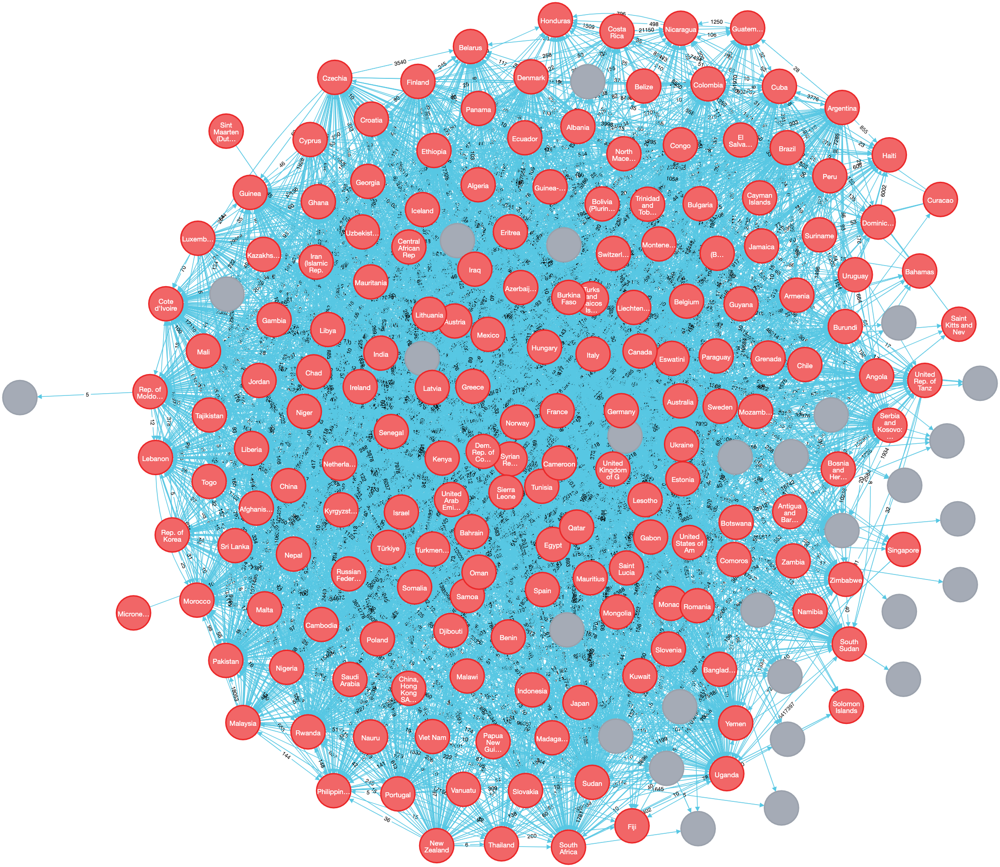

In [37]:
Image(filename='viz/countries accepting 2.png')

## Most popular Country granting asylum--PageRank

In [22]:
#Double check to ensure we call the correct graph
my_create_graph_1_accept_refugees()
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Andorra,[Country]
4,Angola,[Country]
...,...,...
200,Yemen,[Country]
201,Zambia,[Country]
202,Zimbabwe,[Country]
203,None,[]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Albania,[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Argentina,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Armenia,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Australia,[Country]
4,Afghanistan,[Country],IS_CONNECTED_TO,Austria,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Thailand,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Türkiye,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,United Kingdom of Great Britain and Northern I...,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,United States of America,[Country]


-------------------------
  Density: 0.3
-------------------------


In [23]:
# PageRank
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [24]:
query = """

CALL gds.pageRank.stream('ds_graph', {
  maxIterations: $max_iterations,
  dampingFactor: $damping_factor
})
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as page_rank
ORDER BY score DESC, name ASC
LIMIT 10

"""

max_iterations = 20
damping_factor = 0.85
my_neo4j_run_query_pandas(
    query,
    max_iterations=max_iterations,
    damping_factor=damping_factor
)

,name,page_rank
0,Canada,16.831657
1,United States of America,15.066147
2,Germany,13.546686
3,Rep. of Moldova,12.070382
4,Sweden,8.582291
5,Switzerland,7.346083
6,United Kingdom of Great Britain and Northern I...,5.962836
7,France,5.761682
8,Australia,5.541997
9,Ireland,4.599003


In [26]:
#Double check...Here the country with most asylum_seekers is USA, not Canada. 

top_asylum_granter = population3.groupby(['coa'])['asylum_seekers'].sum()
top_asylum_granter_df=pd.DataFrame(top_asylum_granter)
top_asylum_granter_df.sort_values(by=['asylum_seekers'])

,asylum_seekers
coa,
SOL,0
SXM,0
COI,0
MCO,0
MTS,0
...,...
PER,2372036
TUR,2502129
RSA,3402218


## The application of PageRank algorithm on first graph( coo to coa) tells us that the most influential country in granting asylum is Canada, followed by United States of America, Germany, and Republic of Moldova. 

If we only look at the sum of asylum seekers or refugees, USA has the most highest number. However, PageRank tells us the overall influence of a node in graphy, including direct and indirect influence. Apparently, Canada is connecting to more influential countries than USA.

Apparently, high number does not equal to high influence

## A little bit info about Moldova:

Moldova is an Eastern European country, bounded by Ukraine to the north, east, and south and by Romania to the west.(https://www.britannica.com/place/Moldova/People)

## Most influential countries creating refugees--PageRank

In [27]:
my_create_graph_2_origin_refugees()
my_neo4j_nodes_relationships()

-------------------------
  Nodes:
-------------------------


,node_name,labels
0,Afghanistan,[Country]
1,Albania,[Country]
2,Algeria,[Country]
3,Angola,[Country]
4,Antigua and Barbuda,[Country]
...,...,...
200,None,[]
201,None,[]
202,None,[]
203,None,[]


-------------------------
  Relationships:
-------------------------


,node_name_1,node_1_labels,relationship_type,node_name_2,node_2_labels
0,Afghanistan,[Country],IS_CONNECTED_TO,Iran (Islamic Rep. of),[Country]
1,Afghanistan,[Country],IS_CONNECTED_TO,Iraq,[Country]
2,Afghanistan,[Country],IS_CONNECTED_TO,Pakistan,[Country]
3,Afghanistan,[Country],IS_CONNECTED_TO,Türkiye,[Country]
4,Albania,[Country],IS_CONNECTED_TO,Afghanistan,[Country]
...,...,...,...,...,...
5645,Zimbabwe,[Country],IS_CONNECTED_TO,Sierra Leone,[Country]
5646,Zimbabwe,[Country],IS_CONNECTED_TO,Somalia,[Country]
5647,Zimbabwe,[Country],IS_CONNECTED_TO,South Sudan,[Country]
5648,Zimbabwe,[Country],IS_CONNECTED_TO,Sudan,[Country]


-------------------------
  Density: 0.3
-------------------------


In [28]:
# PageRank
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [29]:
query = """


CALL gds.pageRank.stream('ds_graph', {
  maxIterations: $max_iterations,
  dampingFactor: $damping_factor
})
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as page_rank
ORDER BY score DESC, name ASC
LIMIT 10

"""

max_iterations = 20
damping_factor = 0.85

my_neo4j_run_query_pandas(
    query,
    max_iterations=max_iterations,
    damping_factor=damping_factor
)


,name,page_rank
0,Sudan,6.495464
1,Syrian Arab Rep.,6.494630
2,Iraq,6.429535
3,Somalia,6.367514
4,Ethiopia,5.575553
5,Afghanistan,5.469193
6,Iran (Islamic Rep. of),5.277557
7,Dem. Rep. of the Congo,5.029114
8,Eritrea,4.815625
9,Pakistan,4.572956


## The most influential country in creating refugee is Sudan, closely followed by Syrian, Iraq, and Somalia.

In [62]:
find_countries = ['CAN', 'USA']
syria_df = gb2[gb2['coo'] == 'SYR'].sort_values('refugees', ascending=False)
syria_df.insert(0, 'rank', range(1, 1 + len(syria_df)))
print('Total relationships:', len(syria_df))
display(syria_df.head(10))
print('Countries not in top 10 but of interest:')
for country in find_countries:
    display(syria_df[syria_df['coa'] == country])

Total relationships: 125


,rank,coo,coa,refugees,asylum_seekers
4832,1,SYR,TUR,29257140,1580
4779,2,SYR,LEB,9561936,1542
4770,3,SYR,JOR,6705304,3396
4756,4,SYR,GFR,3943021,545351
4767,5,SYR,IRQ,2486202,5933
4719,6,SYR,ARE,1318272,85
4825,7,SYR,SWE,877732,99194
4822,8,SYR,SUD,489265,1929
4723,9,SYR,AUS,394592,69064
4798,10,SYR,NET,275349,42689


Countries not in top 10 but of interest:


,rank,coo,coa,refugees,asylum_seekers
4734,33,SYR,CAN,14683,4867


,rank,coo,coa,refugees,asylum_seekers
4837,21,SYR,USA,72708,28993


## Select Top Asylum Granter, USA, show how reguees flow fromt he top refugee creators--Minimum Spanning Tree

In [88]:
def my_neo4j_wipe_out_mst_relationships():
    "wipe out mst relationships"
    
    query = "match (node)-[relationship:MST]->() delete relationship"
    session.run(query)

In [89]:
my_neo4j_wipe_out_mst_relationships()

In [90]:
my_create_graph_2_origin_refugees()

In [91]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 
                        {
                            IS_CONNECTED_TO: {
                                properties: 'weight',
                                orientation: 'UNDIRECTED'
                            }
                        }
                       )

"""

session.run(query)

In [92]:
query = """

MATCH (n:Country {name: $source})
CALL gds.beta.spanningTree.write('ds_graph',
                                          {sourceNode: id(n),
                                           relationshipWeightProperty: 'weight',
                                           writeProperty: 'writerefugees',
                                           writeRelationshipType: 'MST'
                                          }
                                         )
YIELD preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount
RETURN preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount;

"""

source = "United States of America"

my_neo4j_run_query_pandas(query, source=source)

,preProcessingMillis,computeMillis,writeMillis,effectiveNodeCount
0,0,21,47,177


In [93]:
query = """

MATCH path = (n:Country {name: $source})-[:MST*]-()
WITH relationships(path) AS rels
UNWIND rels AS rel
WITH DISTINCT rel AS rel
RETURN startNode(rel).name AS destination, endNode(rel).name AS source, rel.writerefugees AS refugees

"""

source = "United States of America"

my_neo4j_run_query_pandas(query, source=source)

,destination,source,refugees
0,United States of America,Lithuania,5.0
1,United States of America,Estonia,5.0
2,Estonia,Kazakhstan,5.0
3,Kazakhstan,Georgia,5.0
4,Kazakhstan,Bulgaria,5.0
...,...,...,...
171,Cameroon,Niger,5.0
172,Niger,Guinea,10.0
173,Guinea,Madagascar,6.0
174,Madagascar,Comoros,5.0


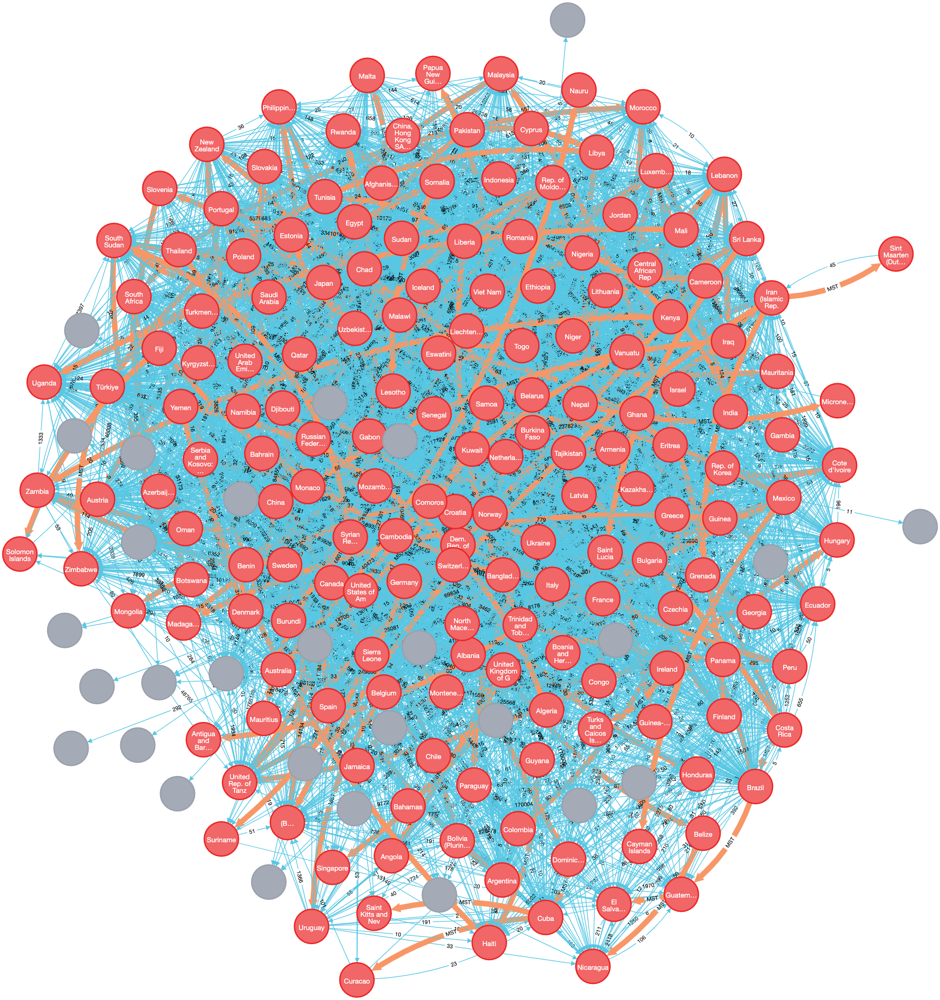

In [83]:
Image(filename='viz/USA_MST.png')

## Select top refugee creators, Syrian, run Minimiing Spanning Tree on the first graph to see how refugees flow tot he top asylum granters

In [69]:
def my_neo4j_wipe_out_mst_relationships():
    "wipe out mst relationships"
    
    query = "match (node)-[relationship:MST]->() delete relationship"
    session.run(query)

In [70]:
my_neo4j_wipe_out_mst_relationships()

In [71]:
my_create_graph_1_accept_refugees()

In [72]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 
                        {
                            IS_CONNECTED_TO: {
                                properties: 'weight',
                                orientation: 'UNDIRECTED'
                            }
                        }
                       )

"""

session.run(query)

In [73]:
query = """

MATCH (n:Country {name: $source})
CALL gds.beta.spanningTree.write('ds_graph',
                                          {sourceNode: id(n),
                                           relationshipWeightProperty: 'weight',
                                           writeProperty: 'writerefugees',
                                           writeRelationshipType: 'MST'
                                          }
                                         )
YIELD preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount
RETURN preProcessingMillis, computeMillis, writeMillis, effectiveNodeCount;

"""

source = "Syrian Arab Rep."

my_neo4j_run_query_pandas(query, source=source)

,preProcessingMillis,computeMillis,writeMillis,effectiveNodeCount
0,0,19,28,203


In [74]:
query = """

MATCH path = (n:Country {name: $source})-[:MST*]-()
WITH relationships(path) AS rels
UNWIND rels AS rel
WITH DISTINCT rel AS rel
RETURN startNode(rel).name AS source, endNode(rel).name AS destination, rel.writerefugees AS refugees

"""

source = "Syrian Arab Rep."

my_neo4j_run_query_pandas(query, source=source)

,source,destination,refugees
0,Syrian Arab Rep.,Panama,5.0
1,Syrian Arab Rep.,Mongolia,5.0
2,Syrian Arab Rep.,Montenegro,15.0
3,Syrian Arab Rep.,Bahrain,5.0
4,Syrian Arab Rep.,South Sudan,5.0
...,...,...,...
197,Kyrgyzstan,Dem. People's Rep. of Korea,5.0
198,Luxembourg,Guinea-Bissau,5.0
199,Rwanda,Yemen,5.0
200,Yemen,Haiti,5.0


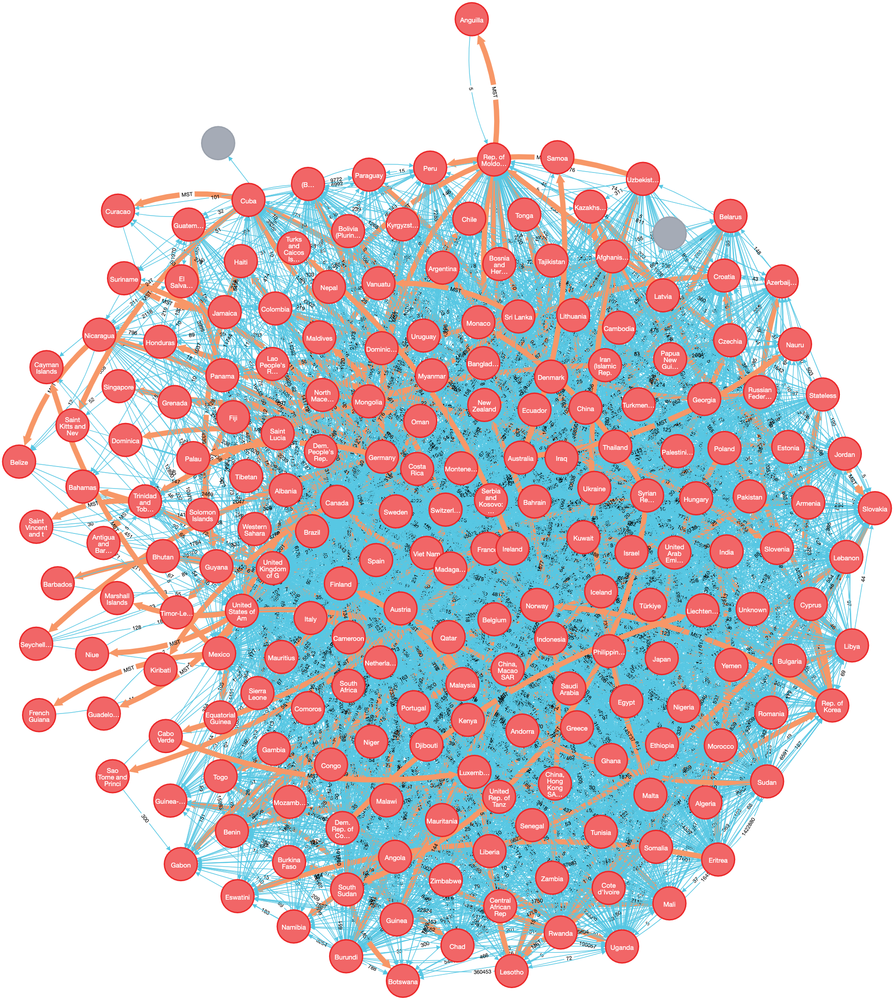

In [76]:
Image(filename='viz/SRY_MST.png')

## Shortest path would needs the coordinates of every country, is that worthy to do so? Or we could focus on telling the flow pattern of refugee?

### Degree Centrality 
swap out which graph function is commented in the next cell to switch degree centrality outputs!
- using graph 1 will show us the countries with the most creation of refugees 
- using graph 2 will show us the countries with the most grant asylum

In [94]:
my_neo4j_wipe_out_database()
my_create_graph_1_accept_refugees()

In [95]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [96]:
query = """

CALL gds.degree.stream('ds_graph')
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as degree
ORDER BY degree DESC, name

"""

my_neo4j_run_query_pandas(query)

,name,degree
0,Syrian Arab Rep.,125.0
1,Iraq,110.0
2,Somalia,110.0
3,Dem. Rep. of the Congo,108.0
4,Sudan,103.0
...,...,...
198,Niue,1.0
199,Palau,1.0
200,Samoa,1.0
201,Tonga,1.0


## By using Degree Centrality, Syrian Arab Repub. was found to be the country with the most creation of refugees, followed by Iraq, Somalia, and Congo.

In [97]:
my_neo4j_wipe_out_database()

my_create_graph_2_origin_refugees()

In [98]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [99]:
query = """

CALL gds.degree.stream('ds_graph')
YIELD nodeId, score
RETURN gds.util.asNode(nodeId).name AS name, score as degree
ORDER BY degree DESC, name

"""

my_neo4j_run_query_pandas(query)

,name,degree
0,Canada,164.0
1,United States of America,163.0
2,Germany,152.0
3,United Kingdom of Great Britain and Northern I...,131.0
4,France,126.0
...,...,...
172,Sint Maarten (Dutch part),1.0
173,Solomon Islands,1.0
174,Vanuatu,1.0
175,Viet Nam,1.0


## Canada is the country with the most asylum granted, followed by USA and Germany.

### Harmonic Centrality
swap out which graph function is commented in the next cell to switch harmonic centrality outputs!
- using graph 1 will tell us the intermediate countries with the highest volume of creating refugees
- using graph 2 will tell us the intermediate countries with the highest volume of granting asylum

In [100]:
my_neo4j_wipe_out_database()


my_create_graph_2_origin_refugees()

In [101]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [102]:
query = """

CALL gds.alpha.closeness.harmonic.stream('ds_graph', {})
YIELD nodeId, centrality
RETURN gds.util.asNode(nodeId).name AS name, centrality as closeness
ORDER BY centrality DESC

"""

my_neo4j_run_query_pandas(query)

,name,closeness
0,Syrian Arab Rep.,0.847538
1,Iraq,0.803977
2,Somalia,0.799242
3,Dem. Rep. of the Congo,0.785511
4,Sudan,0.780777
...,...,...
172,Liechtenstein,0.260038
173,Samoa,0.259943
174,Nauru,0.258996
175,Sint Maarten (Dutch part),0.000000


## By using Harmonic Centrality, Syrian was found to be the intermediate countries with the highest volumne of refugees, followed by Iraq, Somalia, Congo, and Sudan.

In [78]:
my_neo4j_wipe_out_database()

my_create_graph_1_accept_refugees()
#my_create_graph_2_origin_refugees()

In [79]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = "CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', {relationshipProperties: 'weight'})"
session.run(query)

In [80]:
query = """

CALL gds.alpha.closeness.harmonic.stream('ds_graph', {})
YIELD nodeId, centrality
RETURN gds.util.asNode(nodeId).name AS name, centrality as closeness
ORDER BY centrality DESC

"""

my_neo4j_run_query_pandas(query)

,name,closeness
0,United States of America,0.913876
1,Canada,0.913876
2,Germany,0.877990
3,United Kingdom of Great Britain and Northern I...,0.830941
4,France,0.815789
...,...,...
205,Brunei Darussalam,0.000000
206,French Guiana,0.000000
207,Holy See,0.000000
208,Anguilla,0.000000


## USA is the intermediate country with highest volume of asylum granted, followed by Canada and Germany.

### Louvain Modularity
with communities that physically span the sea showing sea port routes that refugees might be taking

In [108]:
my_neo4j_wipe_out_database()

my_create_graph_1_accept_refugees()
#my_create_graph_2_origin_refugees()

In [109]:
query = "CALL gds.graph.drop('ds_graph', false)"
session.run(query)

query = """

CALL gds.graph.project('ds_graph', 'Country', 'IS_CONNECTED_TO', 
                      {relationshipProperties: 'weight'})
"""

session.run(query)

In [110]:
query = """

CALL gds.louvain.stream('ds_graph', {includeIntermediateCommunities: true})
YIELD nodeId, communityId, intermediateCommunityIds
RETURN gds.util.asNode(nodeId).name AS name, communityId as community, intermediateCommunityIds as intermediate_community
ORDER BY community, name ASC

"""

my_neo4j_run_query_pandas(query)

,name,community,intermediate_community
0,Afghanistan,118,"[118, 118]"
1,Albania,118,"[118, 118]"
2,Algeria,118,"[118, 118]"
3,Andorra,118,"[118, 118]"
4,Angola,118,"[118, 118]"
...,...,...,...
198,Sao Tome and Principe,130,"[176, 130]"
199,South Sudan,130,"[176, 130]"
200,Uganda,130,"[130, 130]"
201,United Arab Emirates,130,"[130, 130]"


In [113]:
test=pd.DataFrame(my_neo4j_run_query_pandas(query))
test[test['name']=='Syrian Arab Rep.']

,name,community,intermediate_community
171,Syrian Arab Rep.,118,"[118, 118]"


In [114]:
test[test['community']==118]

,name,community,intermediate_community
0,Afghanistan,118,"[118, 118]"
1,Albania,118,"[118, 118]"
2,Algeria,118,"[118, 118]"
3,Andorra,118,"[118, 118]"
4,Angola,118,"[118, 118]"
...,...,...,...
191,Viet Nam,118,"[118, 118]"
192,Western Sahara,118,"[118, 118]"
193,Yemen,118,"[118, 118]"
194,Zambia,118,"[118, 118]"
